# **Directed Research Project**

In [ ]:
import numpy as np
import imageio.v2 as imageio
import os
import json

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchsummary import summary

from torchvision import transforms
import torchvision.transforms as T

from models.lstm_auto_encoder import LSTMAutoEncoder
from models.lstm_auto_encoder_utils import visualize_model_predictions, evaluate_model

from models.mask_rcnn import create_mask_rcnn_model, visualize_mask_rcnn_predictions
from models.mask_rcnn_opt import create_opt_mask_rcnn_model
from models.mask_rcnn_utils import evaluate_maskrcnn_model

from annotations import load_annotations, visualize_annotations, create_annotations

from custom_dataset import (
    SegmentationDataset, MaskRCNNSegmentationDataset,
    visualize_semantic_dataloader, visualize_maskrcnn_dataloader,
)

from training import segmentation_training, train_mask_rcnn

from utils import (
    createIfNotExist, getImagesInFolder, load_weights, 
    move_files, process_folders, create_pictures_from_patches
)

In [2]:
# Checking CUDA availability and setting the device accordingly
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"{device = }")

device = 'cpu'


### **Data Initialization/visualization**

Initializing list of pictures for cameras 1-3.

In [3]:
dataset_dir = "./Data/lums_plant_database"
os.makedirs(dataset_dir, exist_ok=True)

if os.path.isdir(dataset_dir):
    camera_1 = [os.path.join(dataset_dir, file) for file in os.listdir(dataset_dir) if file.endswith("_cam1.jpg")]
    camera_2 = [os.path.join(dataset_dir, file) for file in os.listdir(dataset_dir) if file.endswith("_cam2.jpg")]
    camera_3 = [os.path.join(dataset_dir, file) for file in os.listdir(dataset_dir) if file.endswith("_cam3.jpg")]


print("camera 1 list length:", len(camera_1))
print("camera 2 list length:", len(camera_2))
print("camera 3 list length:", len(camera_3))

camera 1 list length: 62
camera 2 list length: 47
camera 3 list length: 59


Here I created GIF's to aid in visualization for what each of the cameras captured. $\newline$ 
They can be seen in the "./data/camera_gifs" folder.

In [4]:
camera_dir = "./data/camera_gifs"
os.makedirs(camera_dir, exist_ok=True)

images = []
if not os.path.exists("./data/camera_gifs/cam1.gif"):
    for file in camera_1:
        images.append(imageio.imread(file))
    imageio.mimsave('./data/camera_gifs/cam1.gif', images)
    images = []

if not os.path.exists("./data/camera_gifs/cam2.gif"):
    for file in camera_2:
        images.append(imageio.imread(file))
    imageio.mimsave('./data/camera_gifs/cam2.gif', images)
    images = []

if not os.path.exists("./data/camera_gifs/cam3.gif"):
    for file in camera_3:
        images.append(imageio.imread(file))
    imageio.mimsave('./data/camera_gifs/cam3.gif', images)
    images = []


The progression of the fields from cameras 1-3 is smooth in the beginning. $\newline$ 
Towards the end, the camera lenz either gets shifted, moved, or placed in an entirely different area.  $\newline$ 
These images, towards the end, do not accurately showcase the progression and development of the fields.  $\newline$ 
To fix this, I updated the image lists to ensure that only the correct progression of the plants were shown.  $\newline$ 
This resulted in a decreased timeframe of the field development shown in the cell below.

In [5]:
updated_camera_1 = camera_1[:-23]
uc1_length = len(updated_camera_1)
print("\nCamera 1 list length:", uc1_length)
print("Start:", updated_camera_1[0], "\nEnd:", updated_camera_1[-1])

updated_camera_2 = camera_2[:-6]
uc2_length = len(updated_camera_2)
print("\nCamera 2 list length:", uc2_length)
print("Start:", updated_camera_2[0], "\nEnd:", updated_camera_2[-1])

updated_camera_3 = camera_3[:-11]
uc3_length = len(updated_camera_3)
print("\nCamera 3 list length:", uc3_length)
print("Start:", updated_camera_3[0], "\nEnd:", updated_camera_3[-1])


Camera 1 list length: 39
Start: ./Data/lums_plant_database\2024-02-11_cam1.jpg 
End: ./Data/lums_plant_database\2024-04-05_cam1.jpg

Camera 2 list length: 41
Start: ./Data/lums_plant_database\2024-02-11_cam2.jpg 
End: ./Data/lums_plant_database\2024-03-29_cam2.jpg

Camera 3 list length: 48
Start: ./Data/lums_plant_database\2024-02-11_cam3.jpg 
End: ./Data/lums_plant_database\2024-04-05_cam3.jpg


In [6]:
cleaned_camera_dir = "./data/cleaned_camera_gifs"
os.makedirs(cleaned_camera_dir, exist_ok=True)

images = []
cam1_path = "cam1.gif"
if not os.path.exists(os.path.join(cleaned_camera_dir, cam1_path)):
    for file in updated_camera_1:
        images.append(imageio.imread(file))
    imageio.mimsave(os.path.join(cleaned_camera_dir, cam1_path), images)
    images = []

cam2_path = "cam2.gif"
if not os.path.exists(os.path.join(cleaned_camera_dir, cam2_path)):
    for file in updated_camera_2:
        images.append(imageio.imread(file))
    imageio.mimsave(os.path.join(cleaned_camera_dir, cam2_path), images)
    images = []

cam3_path = "cam3.gif"
if not os.path.exists(os.path.join(cleaned_camera_dir, cam3_path)):
    for file in updated_camera_3:
        images.append(imageio.imread(file))
    imageio.mimsave(os.path.join(cleaned_camera_dir, cam3_path), images)
    images = []

Our data will be comprised of the images captured by camera 2. $\newline$ 
The top view of the images is less complex to handle than the side views captured by camera 1 and 3.

Creating the training and testing data folders

In [7]:
src_path = './data/lums_plant_database'
dest_dir = './data/lums_cam2_images'

createIfNotExist(dest_dir)
camera2_images = getImagesInFolder(path=src_path, extensions='_cam2.jpg')
camera2_images = camera2_images[:uc2_length]

if len([file for file in os.listdir(dest_dir)]) <= len(camera2_images):
    move_files(camera2_images, dest_dir=dest_dir)

We will be training and testing our model on the "./data/lums_cam2_images". $\newline$ 
Since our project and our camera is localized to the LUMS fields, overfitting to this specific location and dataset shouldn't be an issue.

In [8]:
# size for the images
resize = 256

# defining transformation for data preprocessing
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((resize, resize)),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

images_path = './data/lums_cam2_images'
masks_path = './data/lums_cam2_masks'

# Creating training and testing datasets
segmentation_dataset = SegmentationDataset(image_folder_path=images_path, 
                                    mask_folder_path=masks_path, 
                                    transform=transform, 
                                    resize=resize)

# Creating training and testing dataloaders
BATCH_SIZE = 16
train_loader = DataLoader(segmentation_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(segmentation_dataset, batch_size=BATCH_SIZE, shuffle=False)


Visualization of the camera 2 field at a random time.

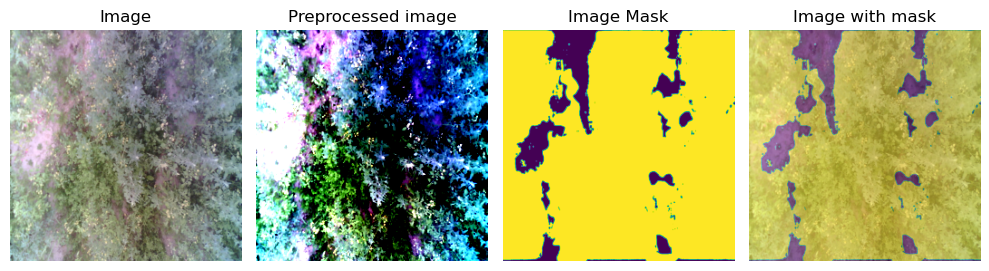

In [9]:
visualize_semantic_dataloader(train_loader)

## **Semantic Segmentation**

### **Initializing LSTM AutoEncoder Model**

This is the baseline model to showcase our results on the LUMS dataset. $\newline$ 
The architecture comprises of an encoder that produces a latent vector of the original image. $\newline$
The sequence is then rearranged to be fed into an LSTM to learn temporal dependancies. $\newline$
Finally, it is put through a decoder to recreate the image mask.

In [10]:
# Hyperparameters
feature_size = 1024
hidden_size = 512
num_layers = 10

# Model, loss, optimizer, scaler, and weights path
lstm_auto_encoder_model = LSTMAutoEncoder(feature_size, hidden_size, num_layers, BATCH_SIZE, device).to(device)

epochs = 50
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(lstm_auto_encoder_model.parameters(), lr=0.00001)

weights_dir = "./weights"
weights_path = os.path.join(weights_dir, "LSTM_AutoEncoder.pth")

os.makedirs(weights_dir, exist_ok=True)

load_weights(lstm_auto_encoder_model, weights_path, device)

if False:    # I change this myself to train or to just load the weights
    training_loss = segmentation_training(lstm_auto_encoder_model, train_loader, epochs, 
                                          criterion, optimizer, device, weights_path)
    lstm_auto_encoder_model.load_state_dict(torch.load(weights_path))

### **Visualization of images, predictions, and score reports**

mIoU isn't good because the masks we manually created where not fully accurate.

In [11]:
evaluate_model(lstm_auto_encoder_model, test_loader, device)

Precison: 0.731
Recall: 0.728
Accuracy: 0.805
Dice: 0.714
mIoU: 0.567


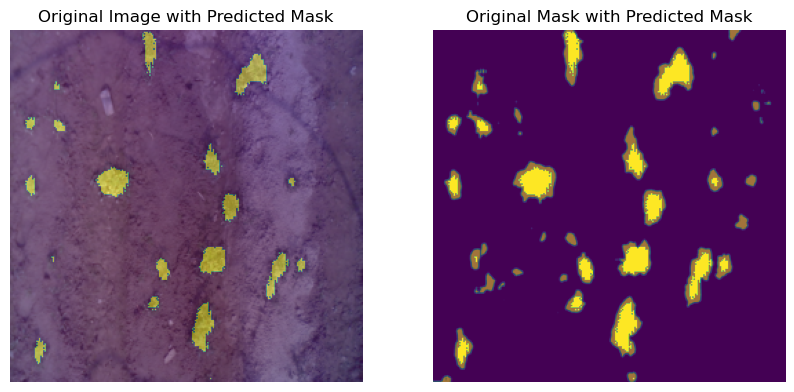

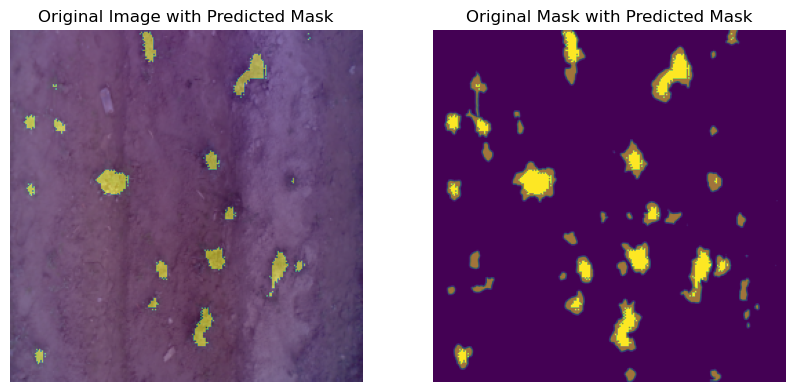

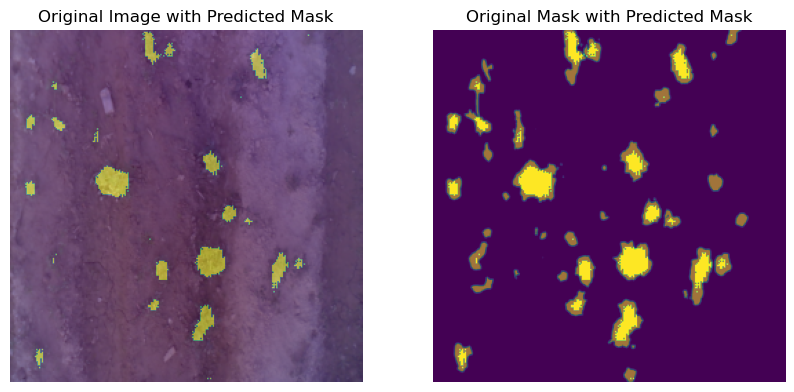

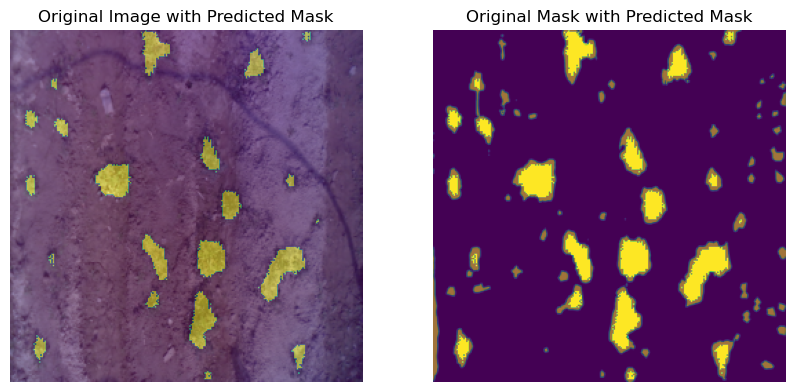

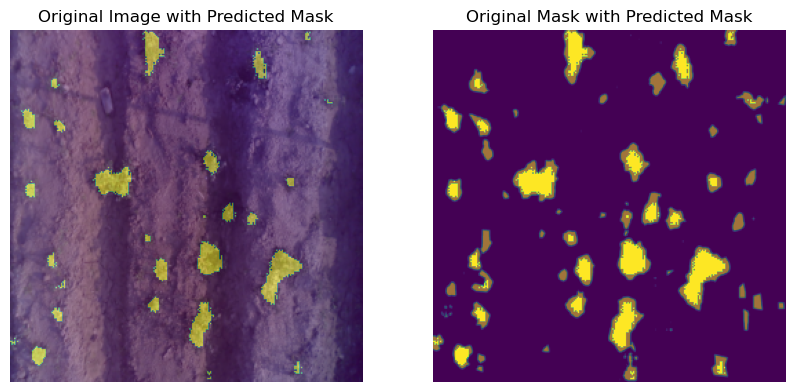

...

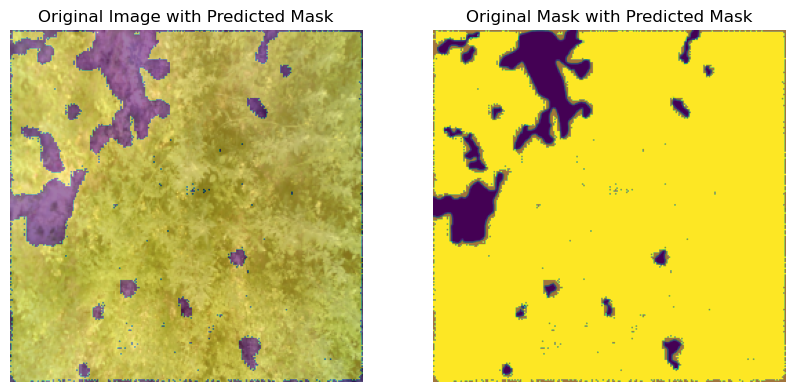

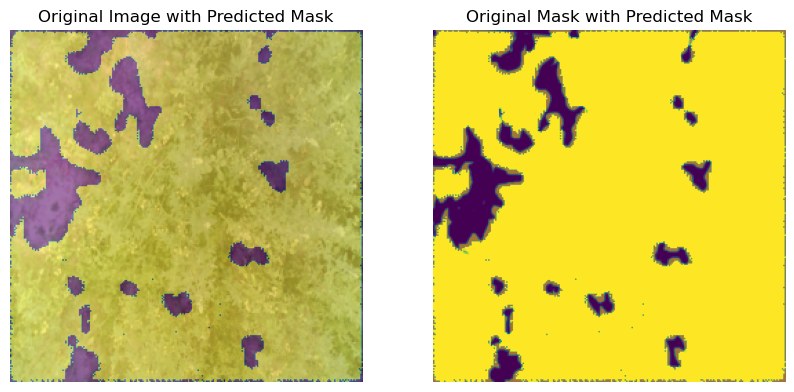

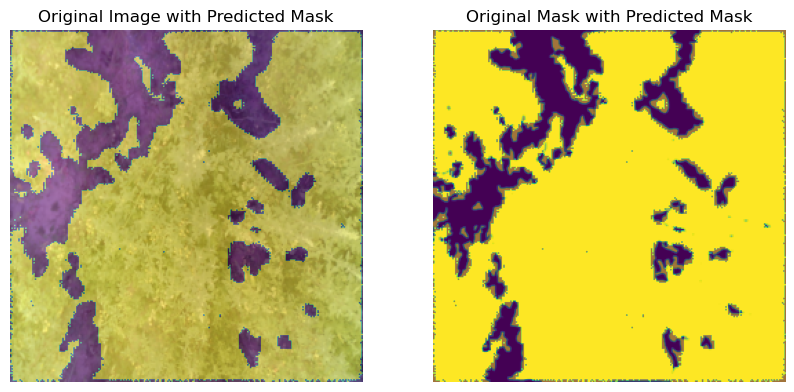

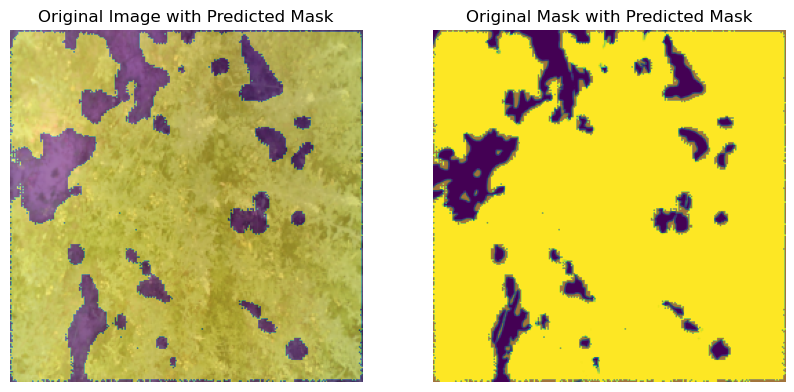

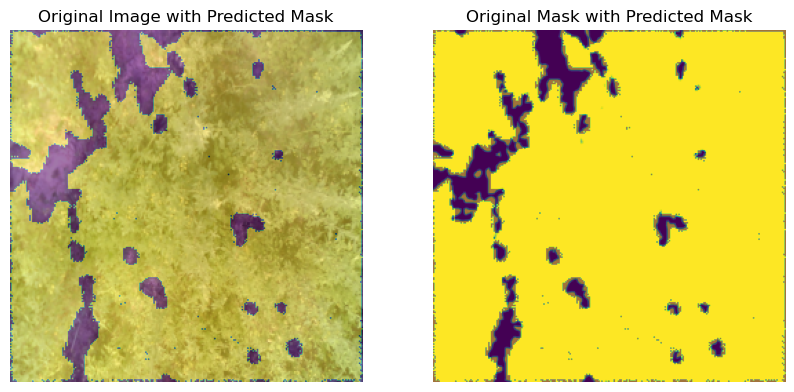

In [12]:
visualize_model_predictions(lstm_auto_encoder_model, test_loader, device)

## **Instance Segmentation**

To tackle instance segmentation with rnns, I will be using a different dataset and altering it to match it to the LUMS field as close as I can. $\newline$ 
My idea is to to use a temporal dataset of plants and join them together to create one image with multiple different plants. $\newline$
By this, I can tackle instance segmentation where each plant has its own mask. $\newline$ 
Moreover, each plant will be in a fixed box and will grow after every image.

### **Dataset preparation**

In [ ]:
base_folder = "./Data/plant_database"
images_dict, masks_dict = process_folders(base_folder)

save_images_folder = "./Data/processed_plant_database/images"
save_masks_folder = "./Data/processed_plant_database/masks"

os.makedirs(save_images_folder, exist_ok=True)
os.makedirs(save_masks_folder, exist_ok=True)
    
set_of_images = []
set_of_masks = []
for key in images_dict.keys():
    if torch.tensor(np.array(images_dict[key])).shape[0] == 52:
        set_of_images.append(torch.tensor(np.array(images_dict[key])))
        set_of_masks.append(torch.tensor(np.array(masks_dict[key])))
    
set_of_images = torch.stack(set_of_images)
set_of_masks = torch.stack(set_of_masks)


In [ ]:
create_pictures_from_patches(set_of_images, save_images_folder)
create_pictures_from_patches(set_of_masks, save_masks_folder, True)

#### **Initializating & Visualizing Dataloaders**

In [13]:
# size for the images
resize = 256

# defining transformation for data preprocessing
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((resize, resize)),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

images_path = './data/processed_plant_database/images'
masks_path = './data/processed_plant_database/masks'

# Creating training and testing datasets
segmentation_dataset = SegmentationDataset(image_folder_path=images_path, 
                                           mask_folder_path=masks_path, 
                                           transform=transform, resize=resize)

# Creating training and testing dataloaders
BATCH_SIZE = 16
train_loader_inst = DataLoader(segmentation_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader_inst = DataLoader(segmentation_dataset, batch_size=BATCH_SIZE, shuffle=False)


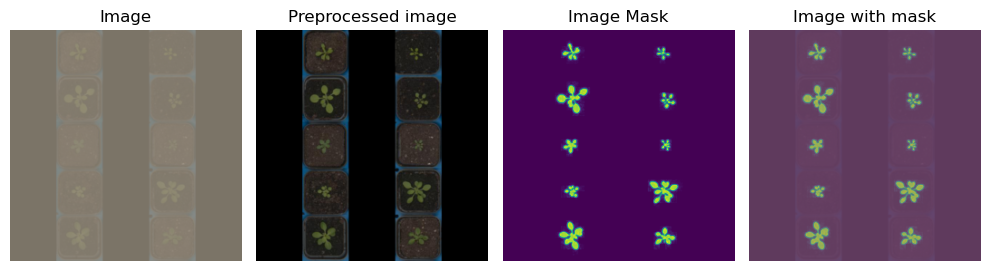

In [14]:
visualize_semantic_dataloader(train_loader_inst)


<span style="color:red"> **Didn't work. Will prepare a different dataset.** <span>

### **Dataset 2.0 preparation**

Initially, I attempted instance segmentation by stitching together images from another dataset, $\newline$ 
but the training didn’t yield good results since my approach was wrong, so I decided to discontinue that approach. $\newline$ 
Instead, I focused on my own LUMS dataset, which I originally created for semantic segmentation. $\newline$ 
I converted it into an instance segmentation dataset, and wrote a utility script, label_utils.py, $\newline$ 
to generate the corresponding masks and bounding boxes for each image.

In [15]:
data_path = "./Data/lums_instance_segmentation_data"
output_path = "./annotations.json"
create_annotations(data_path, output_path)

#### **Visualizing training data images with annotations**

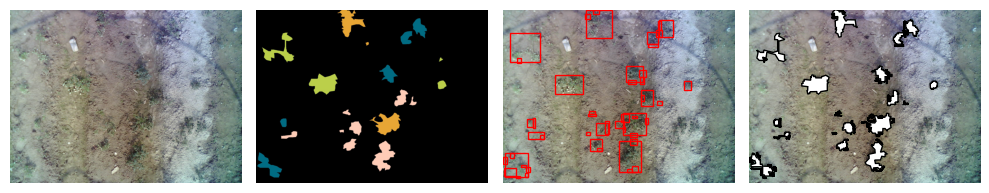

In [16]:
annotations = load_annotations('annotations.json')

# visualizing the first image along with its annotations
image_id = 0
image_name = os.path.join(data_path, annotations['images'][image_id]['file_name'])
label_name = os.path.join(data_path, annotations['images'][image_id]['label_file'])
visualize_annotations(image_name, label_name, image_id, annotations)

#### **Initializating & Visualizing Dataloaders**

In [19]:
def collate_fn(batch):
    images, targets = zip(*batch)
    images = list(images)
    targets = [{k: v for k, v in t.items()} for t in targets]

    return images, targets

data_folder = './Data/lums_instance_segmentation_data'

# defining transform
resize = 256
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((resize, resize)),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Creating training and testing datasets
annotation_file = "annotations.json"
train_dataset_mrcnn = MaskRCNNSegmentationDataset(data_folder=data_folder, annotation_file=annotation_file, transforms=transform)
test_dataset_mrcnn = MaskRCNNSegmentationDataset(data_folder=data_folder, annotation_file=annotation_file, transforms=transform)

# Creating training and testing dataloaders
BATCH_SIZE = 4
train_loader_mrcnn = DataLoader(train_dataset_mrcnn, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn)
test_loader_mrcnn = DataLoader(test_dataset_mrcnn, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn)


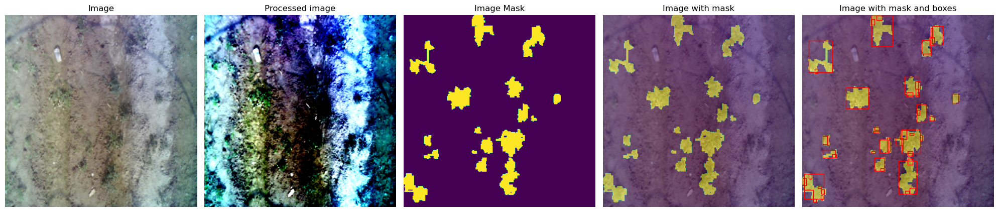

In [20]:
visualize_maskrcnn_dataloader(test_loader_mrcnn)            

### **Initializing MaskRCNN Model**

In [23]:
mask_rcnn_model = create_mask_rcnn_model(2, device)
weights_path_mrcnn = "./weights/Mask_RCNN.pth"

if os.path.exists(weights_path_mrcnn):
    load_weights(mask_rcnn_model, weights_path_mrcnn, device)
    
params = [p for p in mask_rcnn_model.parameters() if p.requires_grad]
optimizer_mrcnn = optim.Adam(params=params, lr=0.0001)
scaler = torch.cuda.amp.GradScaler()
epochs_mrcnn = 30

if False:
    losses = train_mask_rcnn(mask_rcnn_model, train_loader_mrcnn, optimizer_mrcnn, scaler, epochs_mrcnn, device, weights_path_mrcnn)

load_weights(mask_rcnn_model, weights_path_mrcnn, device)


c:\Users\haroo\anaconda3\Lib\site-packages\torch\cuda\amp\grad_scaler.py:126: UserWarning: torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.
  warnings.warn(


MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
         

In [24]:
input_size = (1, 3, 224, 224)
model_summary = summary(mask_rcnn_model, input_size=input_size)
print(model_summary)

Layer (type:depth-idx)                             Param #
├─GeneralizedRCNNTransform: 1-1                    --
├─BackboneWithFPN: 1-2                             --
|    └─IntermediateLayerGetter: 2-1                --
|    |    └─Conv2d: 3-1                            9,408
|    |    └─BatchNorm2d: 3-2                       128
|    |    └─ReLU: 3-3                              --
|    |    └─MaxPool2d: 3-4                         --
|    |    └─Sequential: 3-5                        215,808
|    |    └─Sequential: 3-6                        1,219,584
|    |    └─Sequential: 3-7                        7,098,368
|    |    └─Sequential: 3-8                        14,964,736
|    └─FeaturePyramidNetwork: 2-2                  --
|    |    └─ModuleList: 3-9                        985,088
|    |    └─ModuleList: 3-10                       2,361,344
|    |    └─LastLevelMaxPool: 3-11                 --
├─RegionProposalNetwork: 1-3                       --
|    └─AnchorGenerator: 2-3       

### **Visualization of images, predictions, and score reports**

mIoU, Dice, and Accuracy scores were overall really decent.

In [25]:
evaluate_maskrcnn_model(mask_rcnn_model, test_loader_mrcnn, device)

Leaf Count Accuracy: 84.000%
Precison: 0.921
Recall: 0.896
Accuracy: 0.960
Dice: 0.905
mIoU: 0.847


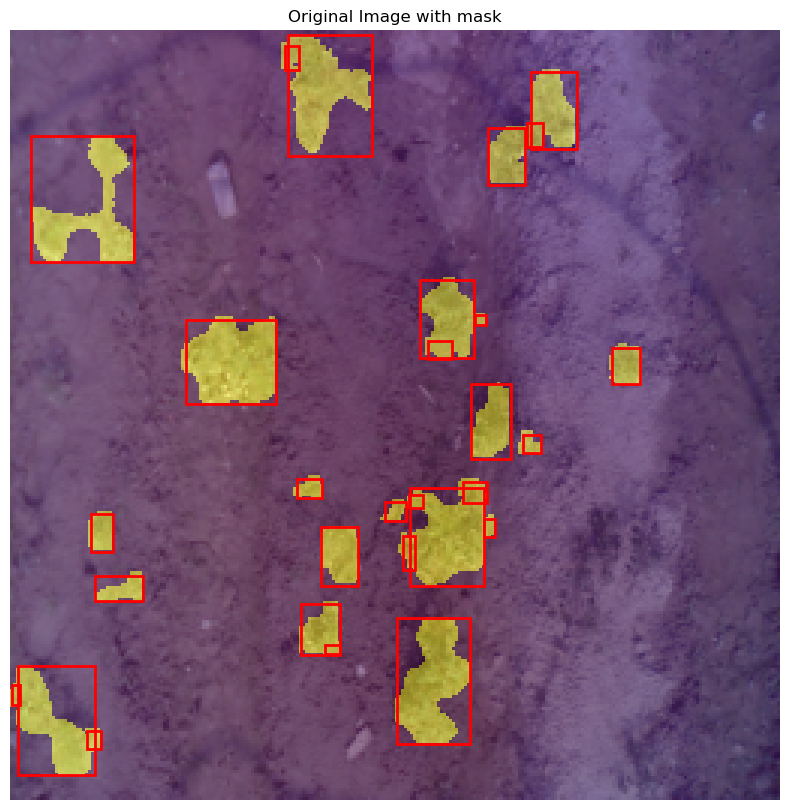

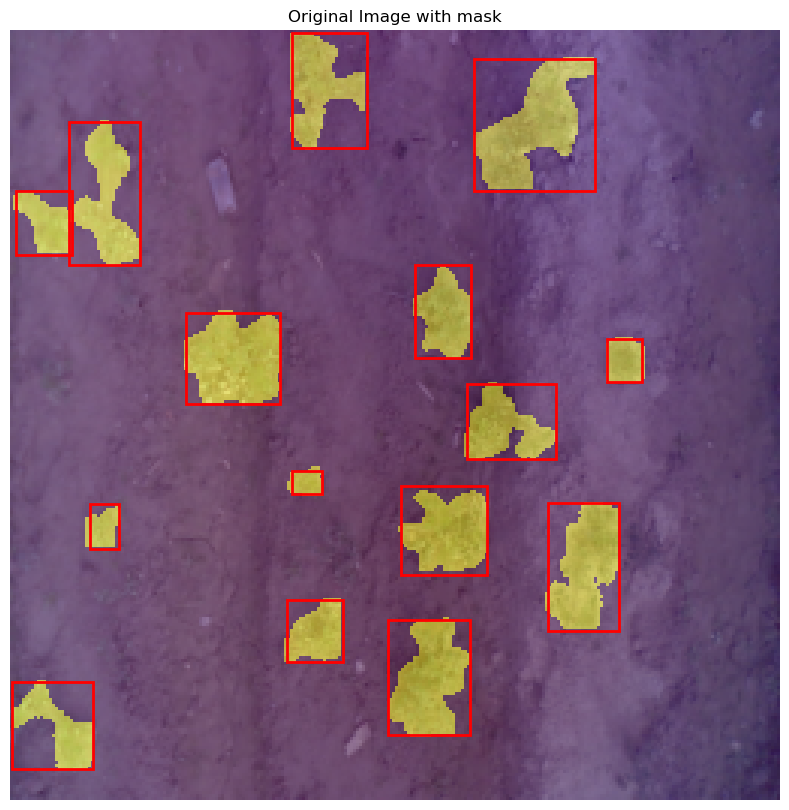

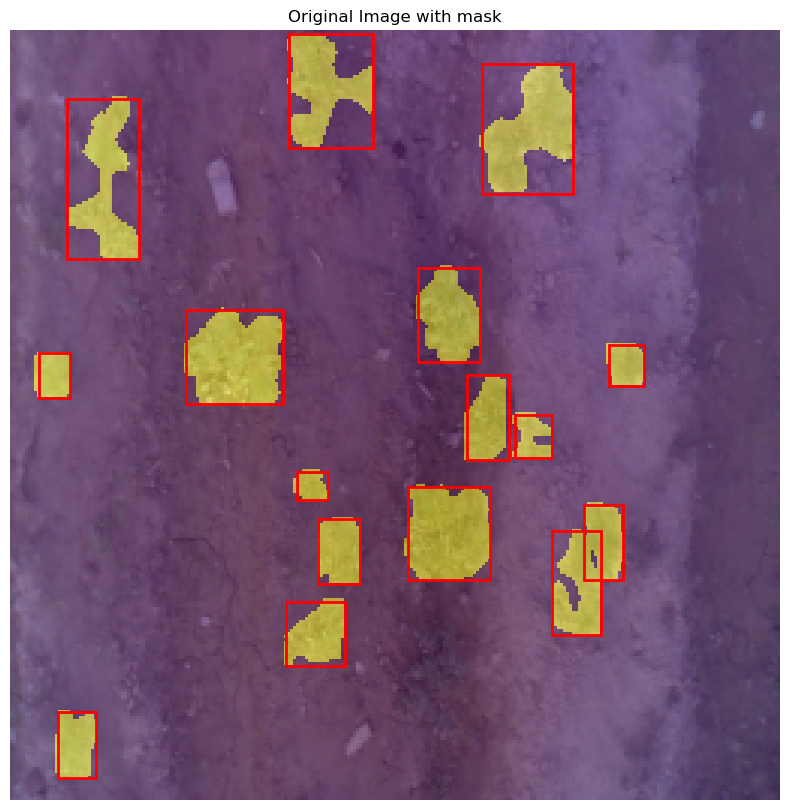

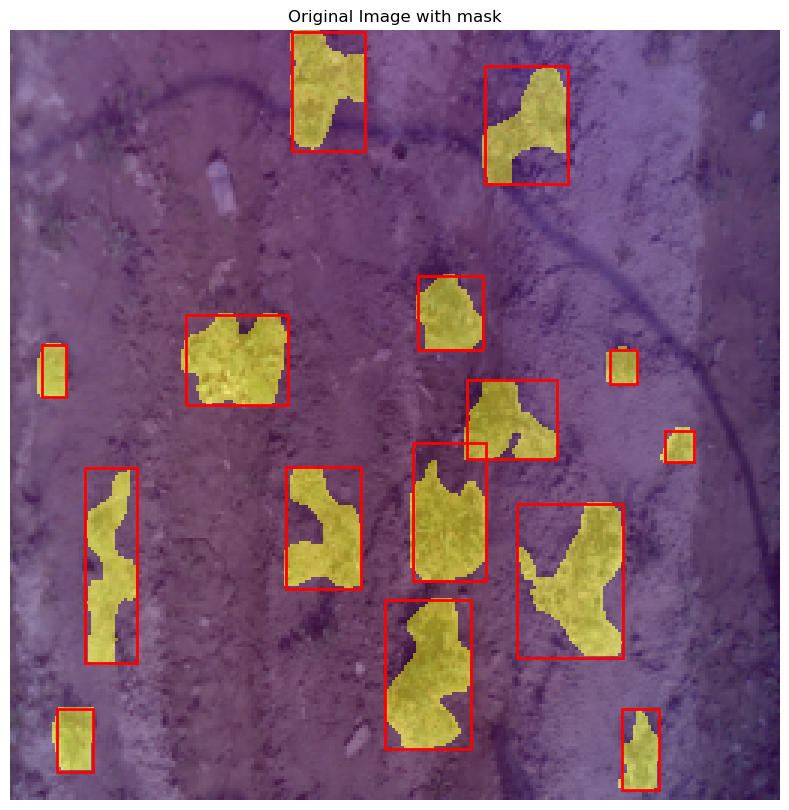

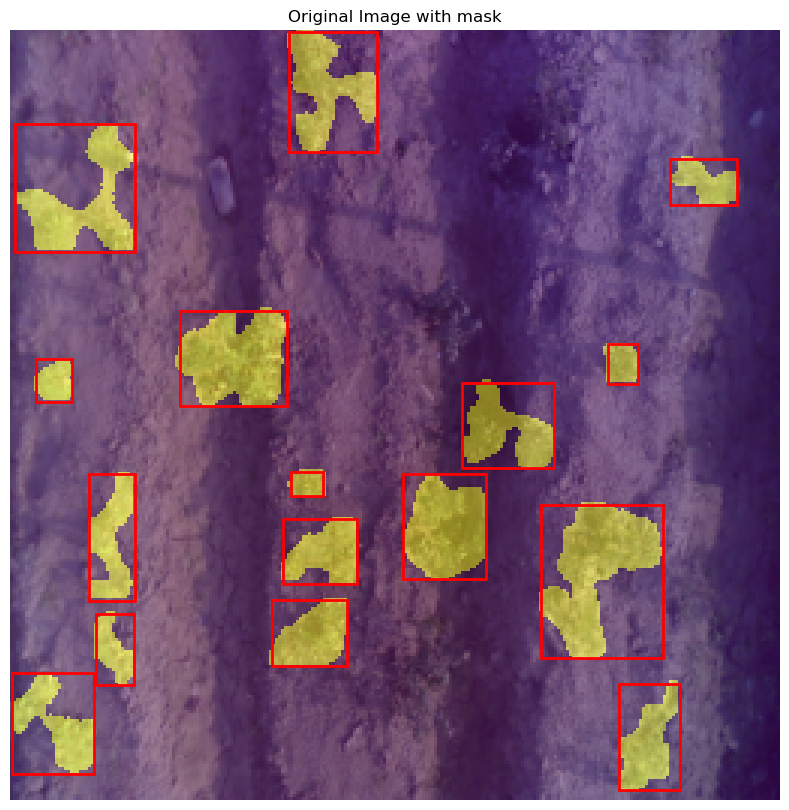

...

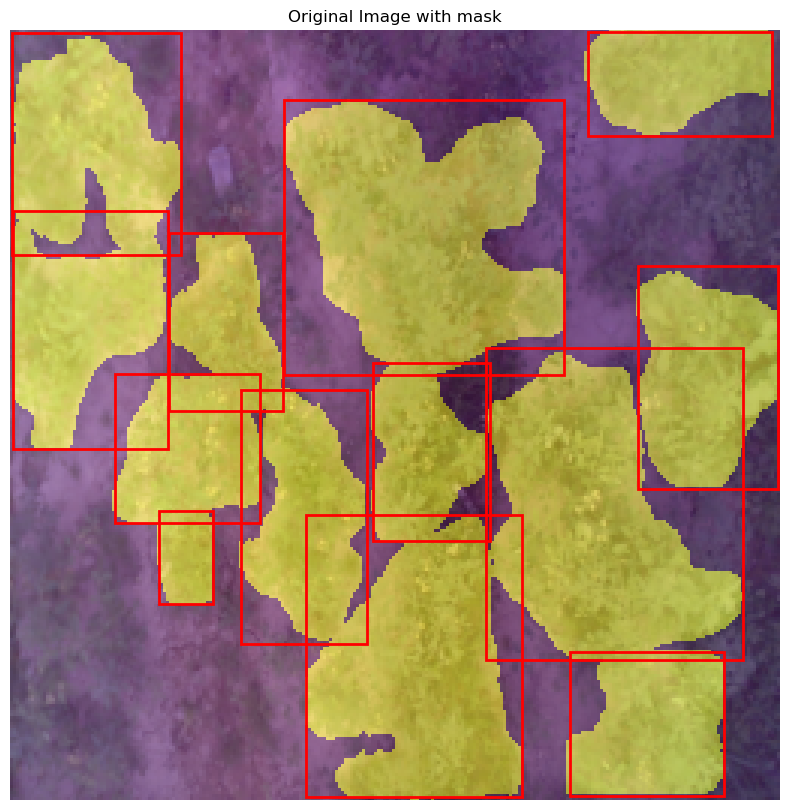

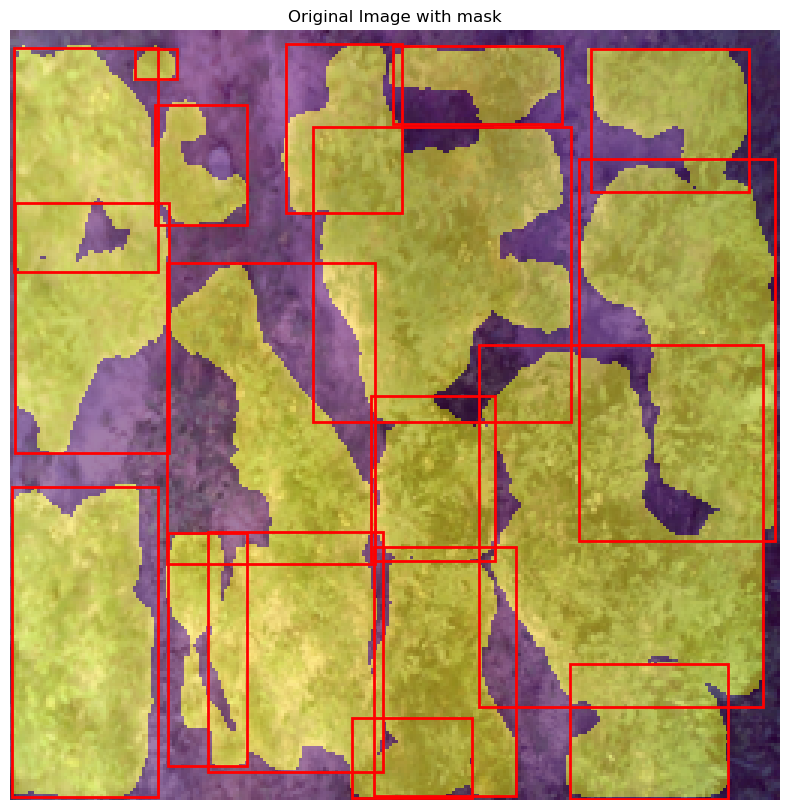

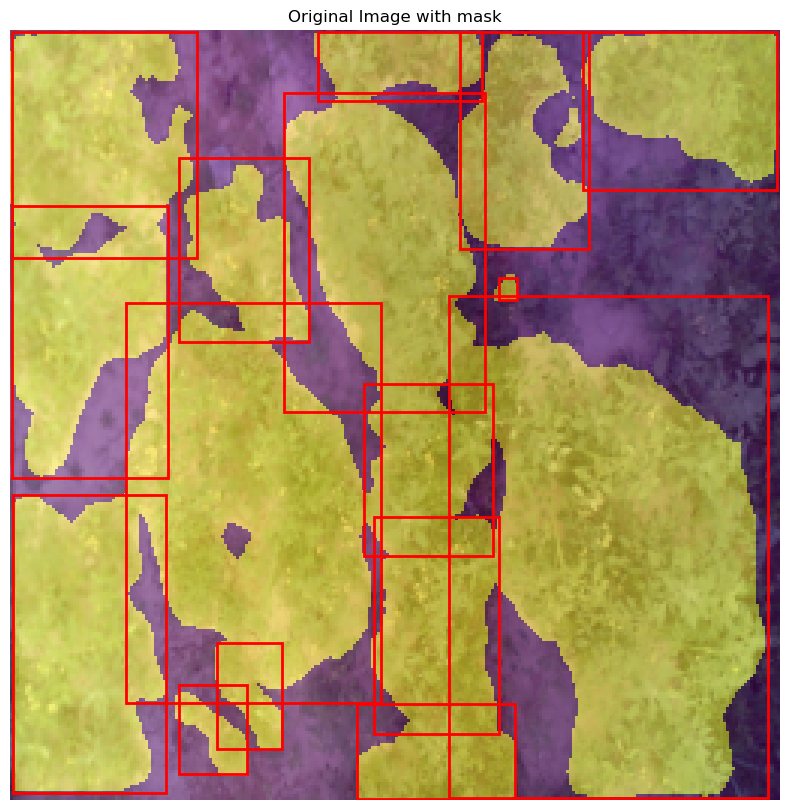

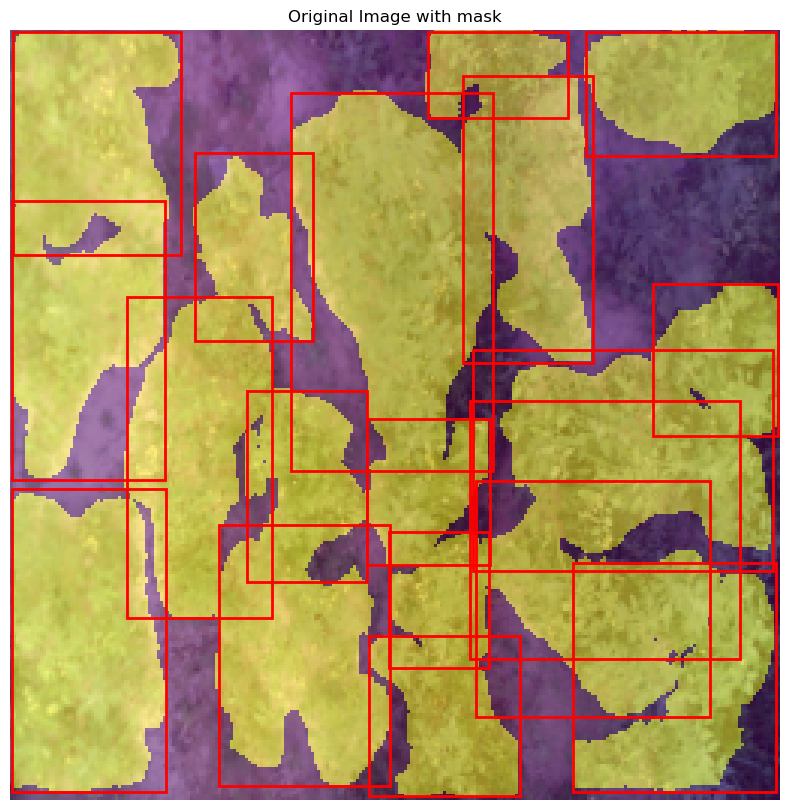

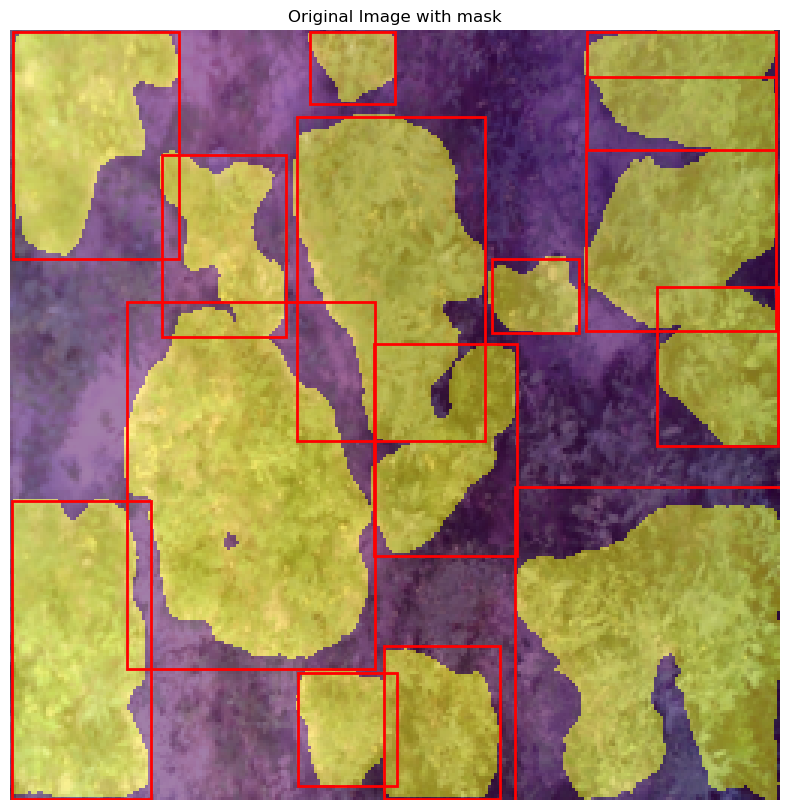

In [26]:
visualize_mask_rcnn_predictions(mask_rcnn_model, test_loader_mrcnn, device)

### **Initializing Optimized MaskRCNN Model**

Next, we wanted to optimize our model to predict better masks and higher leaf count accuracy.

In [29]:
opt_mask_rcnn_model = create_opt_mask_rcnn_model(2, device)
    
params = [p for p in mask_rcnn_model.parameters() if p.requires_grad]
optimizer_mrcnn = optim.Adam(params=params, lr=0.0001)
scaler = torch.cuda.amp.GradScaler()
epochs_mrcnn = 30

# setting the model's device
weights_path_mrcnn_lstm = "./weights/Mask_RCNN_LSTM.pth"
if os.path.exists(weights_path_mrcnn_lstm):
    load_weights(opt_mask_rcnn_model, weights_path_mrcnn_lstm, device)
    
params = [p for p in opt_mask_rcnn_model.parameters() if p.requires_grad]
optimizer_mrcnn = optim.Adam(params=params, lr=0.0001)
scaler = torch.cuda.amp.GradScaler()
epochs_mrcnn = 30

if False:
    losses = train_mask_rcnn(opt_mask_rcnn_model, train_loader_mrcnn, optimizer_mrcnn, scaler, epochs_mrcnn, device, weights_path_mrcnn_lstm)

load_weights(opt_mask_rcnn_model, weights_path_mrcnn_lstm, device)

c:\Users\haroo\anaconda3\Lib\site-packages\torch\cuda\amp\grad_scaler.py:126: UserWarning: torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.
  warnings.warn(


MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
         

In [30]:
input_size = (1, 3, 224, 224)
model_summary = summary(opt_mask_rcnn_model, input_size=input_size)
print(model_summary)

Layer (type:depth-idx)                             Param #
├─GeneralizedRCNNTransform: 1-1                    --
├─BackboneWithFPN: 1-2                             --
|    └─IntermediateLayerGetter: 2-1                --
|    |    └─Conv2d: 3-1                            9,408
|    |    └─BatchNorm2d: 3-2                       128
|    |    └─ReLU: 3-3                              --
|    |    └─MaxPool2d: 3-4                         --
|    |    └─Sequential: 3-5                        215,808
|    |    └─Sequential: 3-6                        1,219,584
|    |    └─Sequential: 3-7                        7,098,368
|    |    └─Sequential: 3-8                        14,964,736
|    └─FeaturePyramidNetwork: 2-2                  --
|    |    └─ModuleList: 3-9                        985,088
|    |    └─ModuleList: 3-10                       2,361,344
|    |    └─LastLevelMaxPool: 3-11                 --
├─RegionProposalNetwork: 1-3                       --
|    └─AnchorGenerator: 2-3       

### **Visualization of images, predictions, and score reports**

In [31]:
evaluate_maskrcnn_model(opt_mask_rcnn_model, test_loader_mrcnn, device)

Leaf Count Accuracy: 92.000%
Precison: 0.922
Recall: 0.886
Accuracy: 0.956
Dice: 0.899
mIoU: 0.838


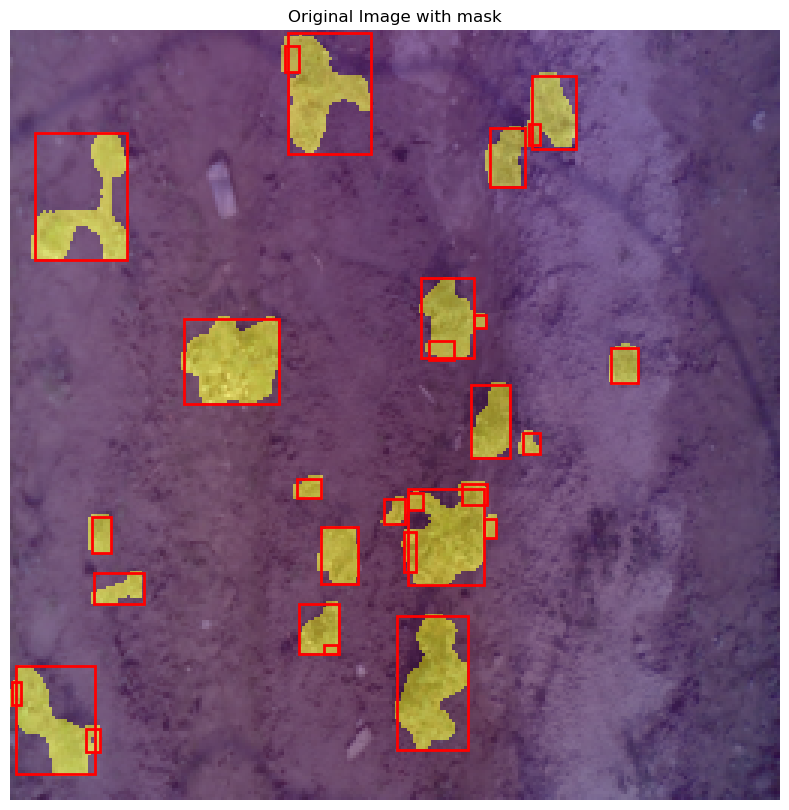

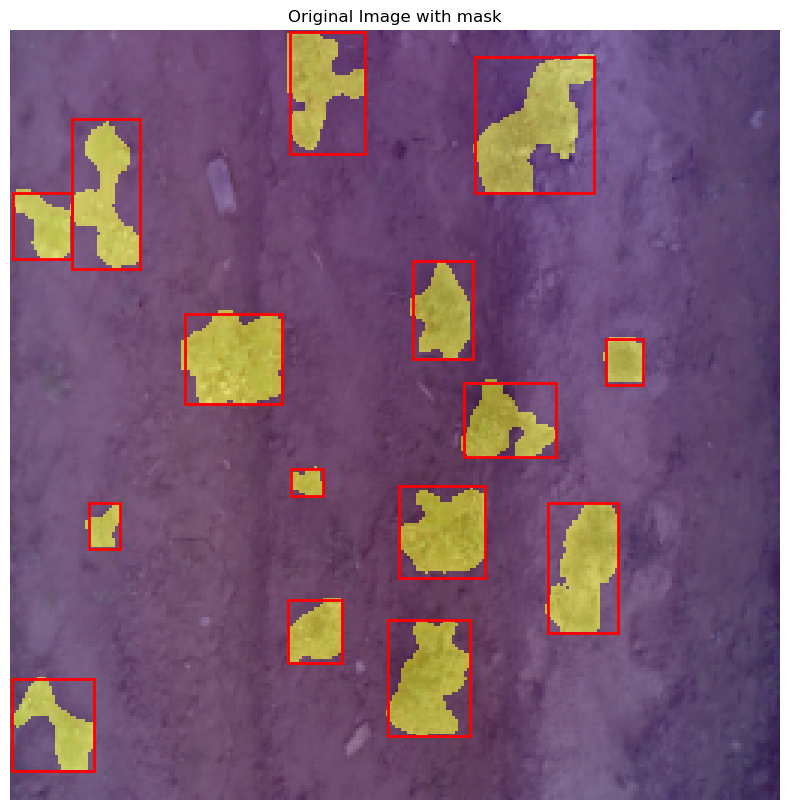

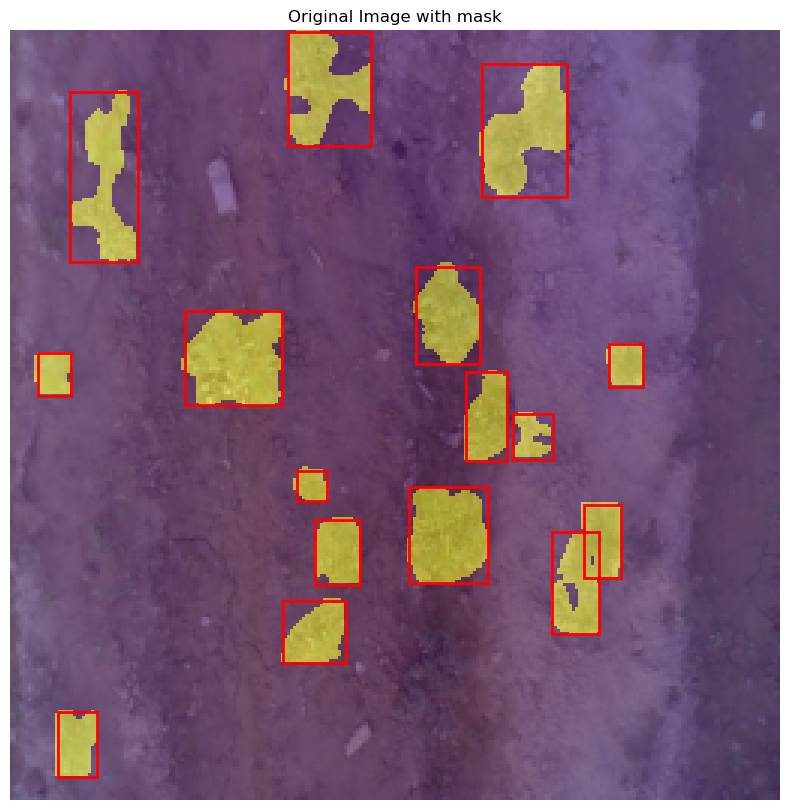

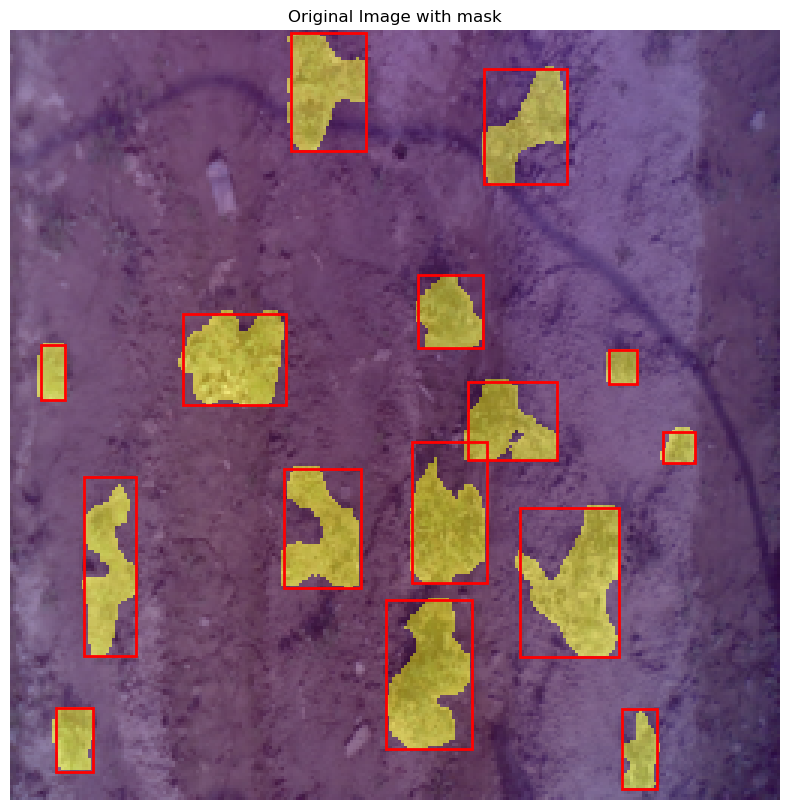

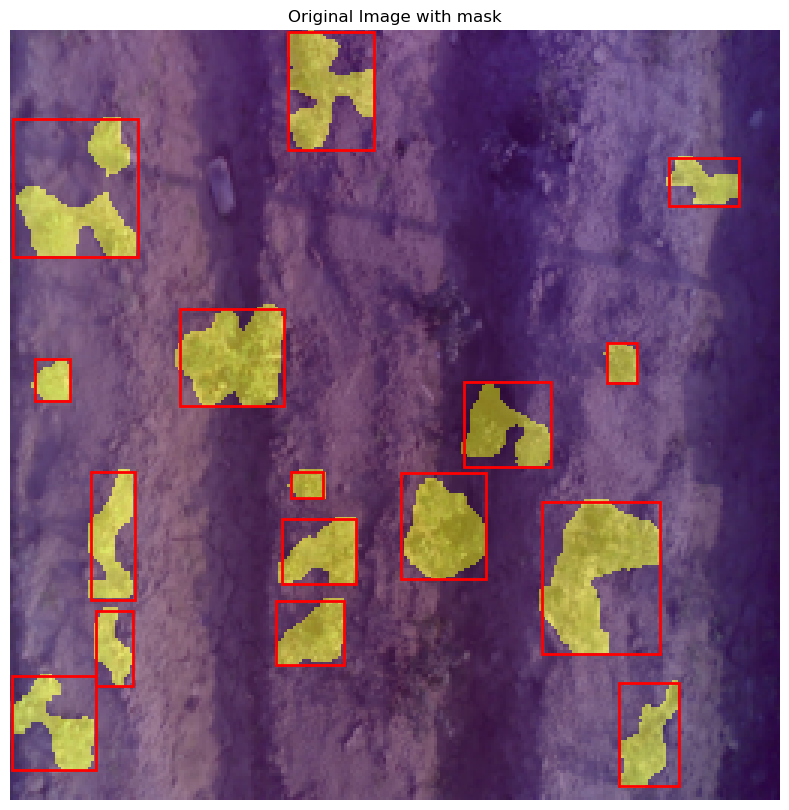

...

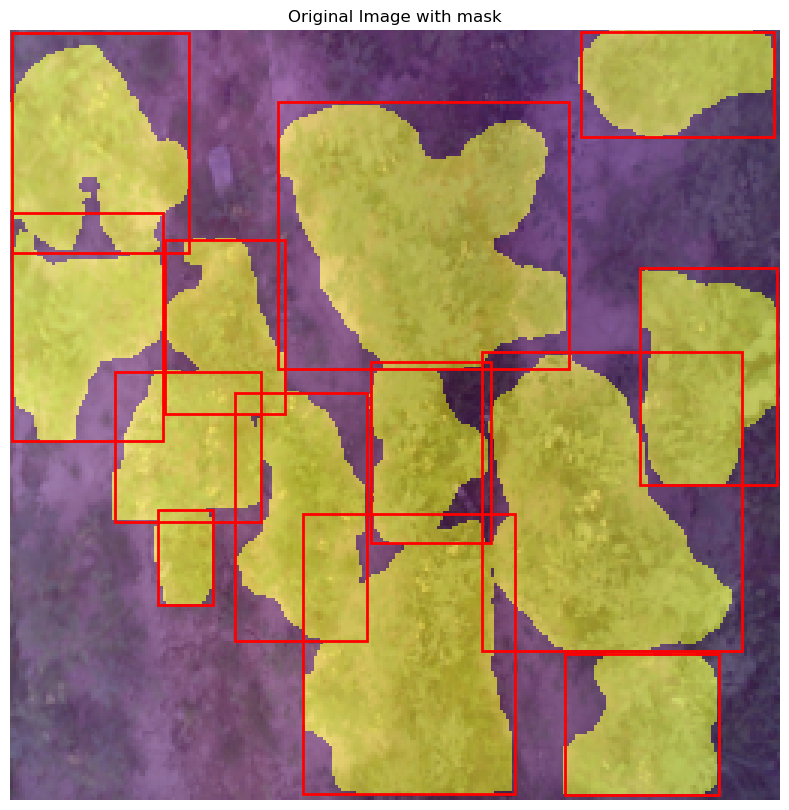

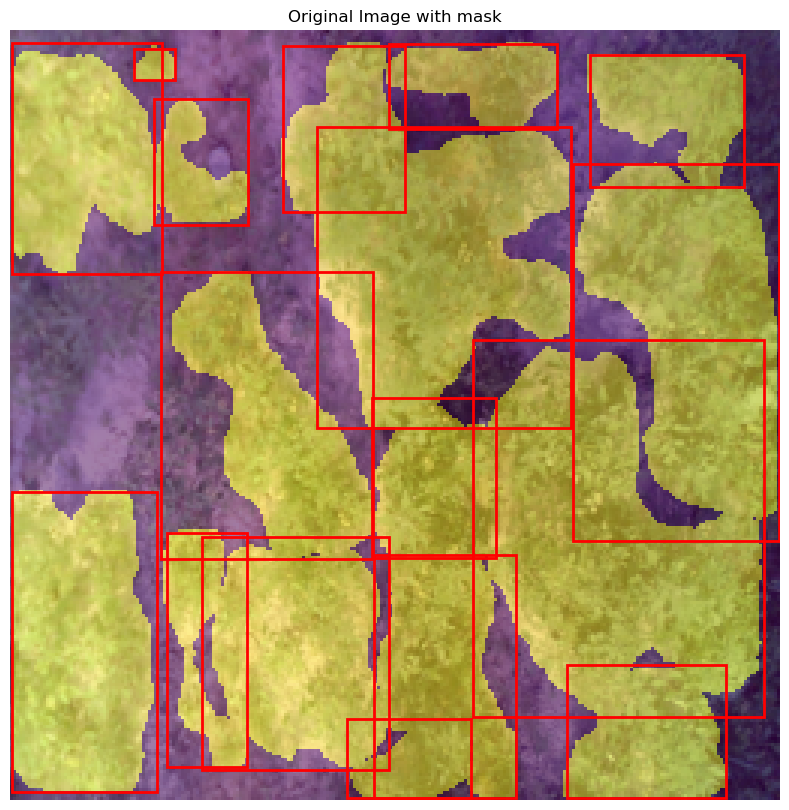

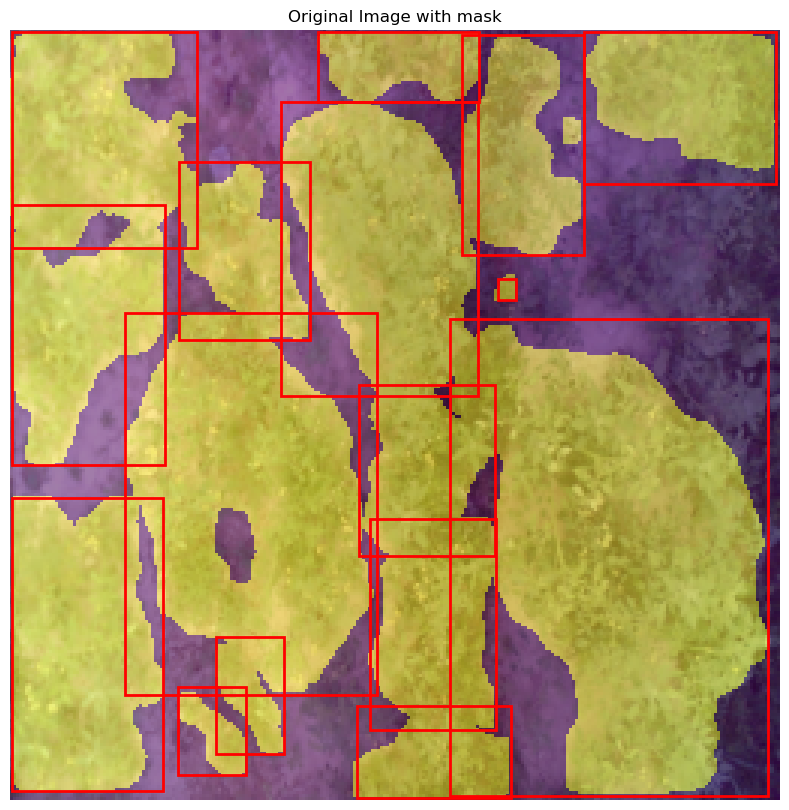

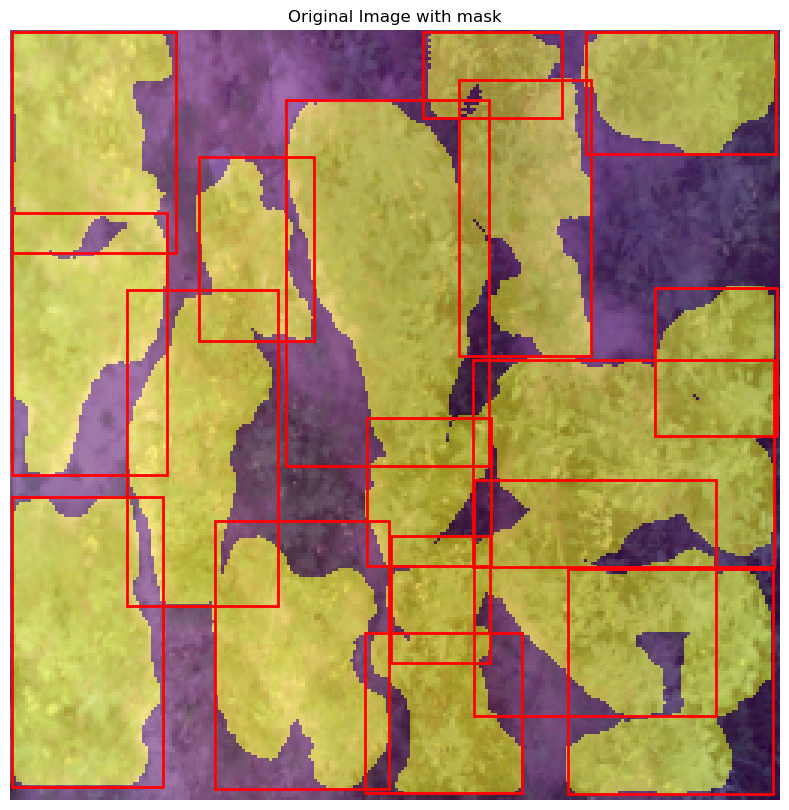

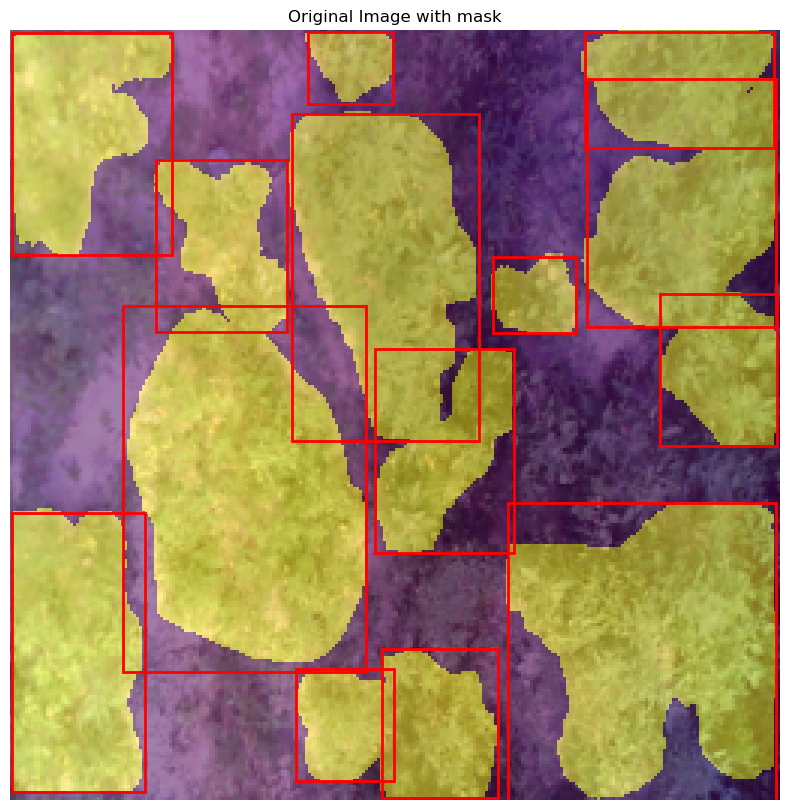

In [32]:
visualize_mask_rcnn_predictions(opt_mask_rcnn_model, test_loader_mrcnn, device)

## **Custom Model - Further Work**

The goal was to create a new model.

### **Dataset Preparation**

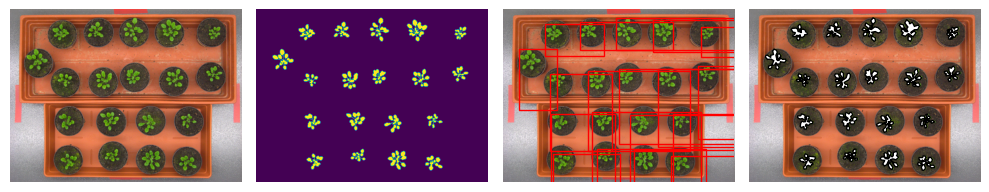

In [33]:
train_dir = './Data/pot_plants_database/train'
annotations_file = os.path.join(train_dir, 'annotations.json')
annotations = load_annotations(annotations_file)

# visualizing the first image along with its annotations
image_id = 4   
image_name = os.path.join(train_dir, annotations['images'][image_id]['file_name'])
label_name = os.path.join(train_dir, annotations['images'][image_id]['label_file'])
visualize_annotations(image_name, label_name, image_id, annotations)

### **Initializing Dataloaders**

In [34]:
class NewSegmentationDataset():
    def __init__(self, data_folder, annotation_file, transforms=None):
        self.data_folder = data_folder
        self.transform = transform
        self.resize = 256
        self.height = self.resize
        self.width = self.resize
        
        with open(annotation_file, 'r') as f:
            self.annotations = json.load(f)
            
        self.images = [os.path.join(data_folder, image['file_name']) for image in self.annotations['images']]
        
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        # Load image
        image_path = self.images[idx]
        image = Image.open(image_path).convert("RGB")

        mask_path = self.images[idx].replace("_rgb", "_fg")
        mask = Image.open(mask_path)
        mask = np.array(mask, dtype=np.uint8)
        
        # Apply transformations if any
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((256, 256)),
        ])
        
        if self.transform is not None:
            image = self.transform(image)
            mask = transform(mask)
        else:
            # Default transformation to Tensor
            image = T.ToTensor()(image)
            mask = T.ToTensor()(mask)
        
        return image, mask


In [35]:
data_folder_train = './Data/pot_plants_database/train'
annotations_train = os.path.join(data_folder_train, 'annotations.json')

data_folder_test = './Data/pot_plants_database/test'
annotations_test = os.path.join(data_folder_test, 'annotations.json')

# defining transform
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((256, 256)),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Creating training and testing datasets
pplant_train_dataset = NewSegmentationDataset(data_folder=data_folder_train, annotation_file=annotations_train, transforms=transform)
pplant_test_dataset = NewSegmentationDataset(data_folder=data_folder_test, annotation_file=annotations_test, transforms=transform)

# Creating training and testing dataloaders
BATCH_SIZE = 4
pplant_train_loader = DataLoader(pplant_train_dataset, batch_size=BATCH_SIZE, shuffle=True)
pplant_test_loader = DataLoader(pplant_test_dataset, batch_size=BATCH_SIZE, shuffle=True)


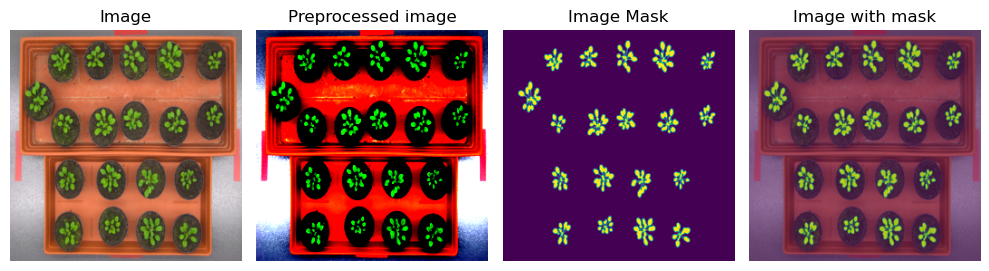

In [36]:
visualize_semantic_dataloader(pplant_train_loader)

In [37]:
from torchvision import models
class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, padding=1, stride=2)
        self.batch_norm = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.conv(x)
        x = self.batch_norm(x)
        x = self.relu(x)
        return x

class MaskDecoder(nn.Module):
    def __init__(self, hidden_dim, output_channels=1):
        super(MaskDecoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(hidden_dim, 512, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.ConvTranspose2d(32, output_channels, kernel_size=3, stride=2, padding=1, output_padding=1),
        )

    def forward(self, x):
        return self.decoder(x)
     
     
class MaskPredictionModel(nn.Module):
    def __init__(self, in_channels=4, out_channels=1, hidden_channels=64):
        super(MaskPredictionModel, self).__init__()
        self.hidden_channels = hidden_channels
        
        self.encoder1 = ConvBlock(in_channels, 64)
        self.encoder2 = ConvBlock(64, 128)
        self.encoder3 = ConvBlock(128, 256)
        self.encoder4 = ConvBlock(256, 512)
        self.encoder5 = ConvBlock(512, 512)
        
        self.lstm = nn.LSTM(input_size=(8*8*512), 
                            hidden_size=1024,
                            num_layers=2,
                            batch_first=True)
        
        self.decoder = MaskDecoder(hidden_channels)
        
    def forward(self, image, mask):
        # Concatenate image and mask features
        x = torch.cat([image, mask], dim=1)

        x = self.encoder1(x)
        x = self.encoder2(x)
        x = self.encoder3(x)
        x = self.encoder4(x)
        x = self.encoder5(x)
        
        batch_size, channels, height, width = x.size()
        x = x.view(batch_size, 1, -1)
        
        lstm_out, _ = self.lstm(x)
        lstm_out = lstm_out[:, -1, :]
        lstm_out = lstm_out.view(batch_size, self.hidden_channels, 4, 4)
        
        x = self.decoder(lstm_out)
        return x
